In [42]:
%matplotlib notebook
import matplotlib.pyplot as plt
import pandas as pd
from pandas.plotting import scatter_matrix
import numpy as np
from sklearn import tree
from sklearn import preprocessing
from sklearn.decomposition import PCA
from functools import reduce
from collections import Counter
from factor_analyzer import FactorAnalyzer

%matplotlib inline

https://www.kaggle.com/c/ieee-fraud-detection

Data Description
In this competition you are predicting the probability that an online transaction is fraudulent, as denoted by the binary target isFraud.

The data is broken into two files identity and transaction, which are joined by TransactionID. Not all transactions have corresponding identity information.

Categorical Features - Transaction
ProductCD
card1 - card6
addr1, addr2
P_emaildomain
R_emaildomain
M1 - M9
Categorical Features - Identity
DeviceType
DeviceInfo
id_12 - id_38
The TransactionDT feature is a timedelta from a given reference datetime (not an actual timestamp).

You can read more about the data from this post by the competition host.

Files
train_{transaction, identity}.csv - the training set
test_{transaction, identity}.csv - the test set (you must predict the isFraud value for these observations)
sample_submission.csv - a sample submission file in the correct format

Transaction Table *

TransactionDT: timedelta from a given reference datetime (not an actual timestamp)

TransactionAMT: transaction payment amount in USD

ProductCD: product code, the product for each transaction

card1 - card6: payment card information, such as card type, card category, issue bank, country, etc.

addr: address

dist: distance

P_ and (R__) emaildomain: purchaser and recipient email domain

C1-C14: counting, such as how many addresses are found to be associated with the payment card, etc. The actual meaning is masked.

D1-D15: timedelta, such as days between previous transaction, etc.

M1-M9: match, such as names on card and address, etc.

Vxxx: Vesta engineered rich features, including ranking, counting, and other entity relations.

Categorical Features:

ProductCD

card1 - card6


addr1, addr2

addr1 as billing region (zipcode)
addr2 as billing country


Pemaildomain Remaildomain

M1 - M9



Identity Table *

Variables in this table are identity information – network connection information (IP, ISP, Proxy, etc) and digital signature 
(UA/browser/os/version, etc) associated with transactions.

They're collected by Vesta’s fraud protection system and digital security partners.

(The field names are masked and pairwise dictionary will not be provided for privacy protection and contract agreement)



Categorical Features:

DeviceType

DeviceInfo

id12 - id38


In [2]:
df = pd.read_csv('ieee-data/train_transaction.csv') #,nrows=50000)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 1.7+ GB


In [3]:
#list(df.columns)

In [4]:
original_categorical = ['TransactionID', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']# Categorical Features - Identity DeviceType DeviceInfo id_12 - id_38 ]
#categorical.extend(['DeviceType', 'DeviceInfo', 'id12 - id38']) need to fix
df[original_categorical].head()

,TransactionID,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,...,R_emaildomain,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,2987000,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,...,NaN,T,T,T,M2,F,T,NaN,NaN,NaN
1,2987001,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,...,NaN,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN
2,2987002,W,4663,490.0,150.0,visa,166.0,debit,330.0,87.0,...,NaN,T,T,T,M0,F,F,F,F,F
3,2987003,W,18132,567.0,150.0,mastercard,117.0,debit,476.0,87.0,...,NaN,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN
4,2987004,H,4497,514.0,150.0,mastercard,102.0,credit,420.0,87.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,3.282270e+06,0.034990,7.372311e+06,135.027176,9898.734658,362.555488,153.194925,199.278897,290.733794,86.800630,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,1.704744e+05,0.183755,4.617224e+06,239.162522,4901.170153,157.793246,11.336444,41.244453,101.741072,2.690623,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,2.987000e+06,0.000000,8.640000e+04,0.251000,1000.000000,100.000000,100.000000,100.000000,100.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,3.134635e+06,0.000000,3.027058e+06,43.321000,6019.000000,214.000000,150.000000,166.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,3.282270e+06,0.000000,7.306528e+06,68.769000,9678.000000,361.000000,150.000000,226.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,3.429904e+06,0.000000,1.124662e+07,125.000000,14184.000000,512.000000,150.000000,226.000000,330.000000,87.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,3.577539e+06,1.000000,1.581113e+07,31937.391000,18396.000000,600.000000,231.000000,237.000000,540.000000,102.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [6]:
df.head(6)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2987005,0,86510,49.0,W,5937,555.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
#n = 10
#df_f = df.iloc[:,1:n+1]
#corr = df_f.corr()


In [8]:
def have_same_nans(ser1,ser2):
    a = ser1.isna() ^ ser2.isna()
    return ~(a.any())

In [9]:
for x in df.columns:
    print(x,end=', ')

TransactionID, isFraud, TransactionDT, TransactionAmt, ProductCD, card1, card2, card3, card4, card5, card6, addr1, addr2, dist1, dist2, P_emaildomain, R_emaildomain, C1, C2, C3, C4, C5, C6, C7, C8, C9, C10, C11, C12, C13, C14, D1, D2, D3, D4, D5, D6, D7, D8, D9, D10, D11, D12, D13, D14, D15, M1, M2, M3, M4, M5, M6, M7, M8, M9, V1, V2, V3, V4, V5, V6, V7, V8, V9, V10, V11, V12, V13, V14, V15, V16, V17, V18, V19, V20, V21, V22, V23, V24, V25, V26, V27, V28, V29, V30, V31, V32, V33, V34, V35, V36, V37, V38, V39, V40, V41, V42, V43, V44, V45, V46, V47, V48, V49, V50, V51, V52, V53, V54, V55, V56, V57, V58, V59, V60, V61, V62, V63, V64, V65, V66, V67, V68, V69, V70, V71, V72, V73, V74, V75, V76, V77, V78, V79, V80, V81, V82, V83, V84, V85, V86, V87, V88, V89, V90, V91, V92, V93, V94, V95, V96, V97, V98, V99, V100, V101, V102, V103, V104, V105, V106, V107, V108, V109, V110, V111, V112, V113, V114, V115, V116, V117, V118, V119, V120, V121, V122, V123, V124, V125, V126, V127, V128, V129, V130,

In [10]:
card_cols = [x for x in df.columns if x.find('card') != -1]
addr_cols = [x for x in df.columns if x.find('addr') != -1]
dist_cols = [x for x in df.columns if x.find('dist') != -1]
email_cols = [x for x in df.columns if x.find('email') != -1]
C_cols = [x for x in df.columns if x.find('C',0,1) != -1]
D_cols = [x for x in df.columns if x.find('D',0,1) != -1]
M_cols = [x for x in df.columns if x.find('M',0,1) != -1]
V_cols = [x for x in df.columns if x.find('V',0,1) != -1]
#card_cols, addr_cols, dist_cols, email_cols, C_cols, D_cols, M_cols, V_cols

In [11]:
cols = df.columns.values.tolist()
cols = V_cols.copy()
same_nans_lst = []
similar0 = [0]
while cols.copy() != []:
    x = cols.pop(0)
    total = df[x].isna().values.sum()
    if total==0:
        similar0.append(x)
    else:
        similar = [total,x]
        for y in cols.copy():
            same = have_same_nans(df[x],df[y])
            if same:
                similar.append(y)
                cols.remove(y)
        same_nans_lst.append(similar)
same_nans_lst.append(similar0)


In [12]:
for lst in same_nans_lst:
    print(lst)

[279287, 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
[76073, 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34']
[168969, 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52']
[77096, 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74']
[89164, 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94']
[314, 'V95', 'V96', 'V97', 'V98', 'V99', 'V100', 'V101', 'V102', 'V103', 'V104', 'V105', 'V106', 'V107', 'V108', 'V109', 'V110', 'V111', 'V112', 'V113', 'V114', 'V115', 'V116', 'V117', 'V118', 'V119', 'V120', 'V121', 'V122', 'V123', 'V124', 'V125', 'V126', 'V127', 'V128', 'V129', 'V130', 'V131', 'V132', 'V13

In [13]:
V_categorical = []
V_non_categorical = []
for lst in same_nans_lst.copy():
    print(lst)
    n = lst[0]
    for col in lst[1:]:
        is_cat = True
        x= df[col].unique()
        x.sort()
        #print(col, x, x.shape)
        for val in x:
            if np.isnan(val):
                pass
            else:
                r = val-int(val)
                if r>0:
                    is_cat = False
                    #print(r, end=" ")
        #print()
        if is_cat:
            V_categorical.append(col)
        else:
            V_non_categorical.append(col)

[279287, 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
[76073, 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34']
[168969, 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52']
[77096, 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74']
[89164, 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94']
[314, 'V95', 'V96', 'V97', 'V98', 'V99', 'V100', 'V101', 'V102', 'V103', 'V104', 'V105', 'V106', 'V107', 'V108', 'V109', 'V110', 'V111', 'V112', 'V113', 'V114', 'V115', 'V116', 'V117', 'V118', 'V119', 'V120', 'V121', 'V122', 'V123', 'V124', 'V125', 'V126', 'V127', 'V128', 'V129', 'V130', 'V131', 'V132', 'V13

In [14]:
print("categorical:\n",V_categorical)
print('\nnon_categorical:\n',V_non_categorical)

categorical:
 ['V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94', 'V95', 'V96', 'V97', 'V98', 'V99', 'V100', 'V101', 'V102', 'V103', 'V104', 'V105', 'V106', 'V107', 'V108', 'V109', 'V110', 'V111', 'V112', 'V113', 'V114', 'V115', 'V116', 'V117', 'V118', 'V119', 'V120', 'V121', 'V122', 'V123', 'V124', 'V125', 'V138', 'V139', 'V140', 'V141', 'V142', 'V146', 'V147', 'V148', 'V149', 'V153', 'V154', 'V155

In [64]:
num_V = len(V_categorical+V_non_categorical)

In [71]:
V_corr = np.zeros((num_V,num_V))
for lst in same_nans_lst:
    for col in lst[1:]:
        col_num=int(col[1:])-1
        for row in lst[1:]:
            row_num=int(row[1:])-1
            V_corr[row_num,col_num]=1

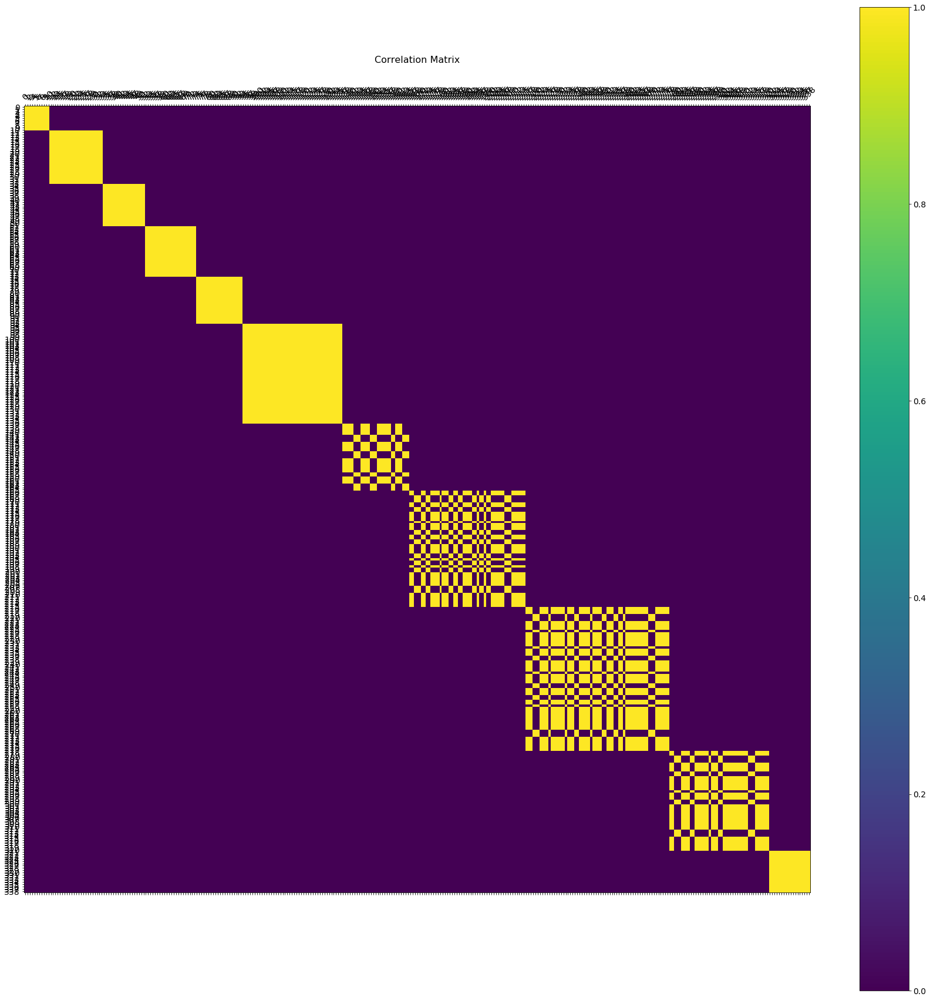

In [72]:
f = plt.figure(figsize=(30, 30))
plt.matshow(V_corr, fignum=f.number)
plt.xticks(range(V_corr.shape[1]), fontsize=14, rotation=45)
plt.yticks(range(V_corr.shape[1]), fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [15]:
for col in V_categorical:
    df[col].fillna(-1,inplace=True)

In [25]:
for col in V_non_categorical:
    df[col].fillna(-1,inplace=True)

In [16]:
df_categorical = df[V_categorical]
sim_cols = same_nans_lst[0][1:]
df_sim = df[sim_cols] 

In [26]:
df_V = df[V_cols]

In [27]:
df_test = df_V

In [29]:
df_test.describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,...,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000
mean,0.054101,0.077956,0.095281,-0.026798,-0.010704,0.078210,0.092537,0.068732,0.076019,-0.228421,...,-0.752354,99.786597,190.992938,140.628936,0.507042,7.389967,3.118094,6.858364,20.218838,13.182222
std,0.998522,1.035879,1.063348,0.975663,0.998782,1.036025,1.058306,1.021339,1.032429,0.823132,...,1.869669,2335.149561,4198.106528,2991.658762,91.141724,146.244671,103.043922,250.394193,412.300408,306.356869
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
50%,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
max,1.000000,8.000000,9.000000,6.000000,6.000000,9.000000,9.000000,8.000000,8.000000,4.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.000000,55125.000000,104060.000000,104060.000000,104060.000000


In [38]:
M = df_test.to_numpy()
M.shape

(590540, 339)

In [46]:
scaler = preprocessing.StandardScaler()
M_scaled = scaler.fit_transform(M)

In [50]:
pca = PCA(n_components=30)  
M_new = pca.fit_transform(M_scaled)
evr = pca.explained_variance_ratio_
print ('explained variance ratio:', evr, sum(evr))  #eigenvalues, scaled to sum to 1
#first dimension explains 30 per cent and second only 6 percent

explained variance ratio: [0.26207079 0.16723979 0.11196915 0.04183838 0.03033551 0.02965486
 0.02496557 0.02385969 0.02047761 0.01810183 0.0179175  0.01769872
 0.01547768 0.0137623  0.01122711 0.00986886 0.00972254 0.00933247
 0.00898375 0.00844866 0.00747729 0.00715968 0.00630557 0.00608614
 0.00587591 0.00455373 0.00417382 0.00411154 0.00404084 0.00387443] 0.9066117263736969


In [30]:
from factor_analyzer.factor_analyzer import calculate_kmo
from factor_analyzer.factor_analyzer import calculate_bartlett_sphericity

In [31]:
chi_square_value,p_value=calculate_bartlett_sphericity(df_test)
chi_square_value, p_value

/usr/local/lib/python3.6/dist-packages/factor_analyzer/factor_analyzer.py:118: RuntimeWarning: divide by zero encountered in log
  statistic = -np.log(corr_det) * (n - 1 - (2 * p + 5) / 6)
/home/ubuntu/.local/lib/python3.6/site-packages/scipy/stats/_continuous_distns.py:1194: RuntimeWarning: invalid value encountered in subtract
  return sc.xlogy(df/2.-1, x) - x/2. - sc.gammaln(df/2.) - (np.log(2)*df)/2.


(inf, nan)

In [32]:
kmo_all,kmo_model=calculate_kmo(df_test)
kmo_model

/usr/local/lib/python3.6/dist-packages/factor_analyzer/utils.py:248: UserWarning: The inverse of the variance-covariance matrix was calculated using the Moore-Penrose generalized matrix inversion, due to its determinant being at or very close to zero.
  warnings.warn('The inverse of the variance-covariance matrix '


0.9220400884212169

In [51]:
# Create factor analysis object and perform factor analysis
fa = FactorAnalyzer(n_factors=30, rotation=None)
fa.fit(df_test)
# Check Eigenvalues
ev, v = fa.get_eigenvalues()
ev

array([8.88419973e+01, 5.66942892e+01, 3.79575407e+01, 1.41832118e+01,
       1.02837395e+01, 1.00529970e+01, 8.46332690e+00, 8.08843387e+00,
       6.94191114e+00, 6.13651970e+00, 6.07403358e+00, 5.99986572e+00,
       5.24693301e+00, 4.66542064e+00, 3.80598975e+00, 3.34554275e+00,
       3.29594050e+00, 3.16370603e+00, 3.04549197e+00, 2.86409688e+00,
       2.53480114e+00, 2.42713125e+00, 2.13759019e+00, 2.06320150e+00,
       1.99193364e+00, 1.54372165e+00, 1.41499788e+00, 1.39385918e+00,
       1.36987239e+00, 1.31383274e+00, 1.21571162e+00, 1.13608939e+00,
       1.04140223e+00, 1.00368810e+00, 9.64615819e-01, 9.07020927e-01,
       8.41408463e-01, 8.10425595e-01, 7.85436201e-01, 7.29125577e-01,
       6.83621671e-01, 6.56143673e-01, 6.34741937e-01, 5.99668207e-01,
       5.91259025e-01, 5.76128963e-01, 5.16715797e-01, 4.97579876e-01,
       4.80950777e-01, 4.74698715e-01, 4.52371280e-01, 4.30015613e-01,
       4.11824638e-01, 3.93028374e-01, 3.71935840e-01, 3.57708103e-01,
      

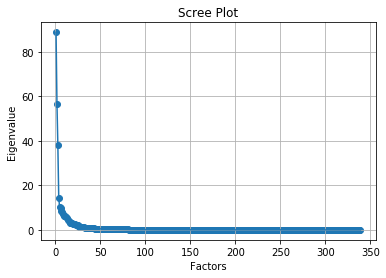

In [52]:
# Create scree plot using matplotlib
plt.scatter(range(1,df_test.shape[1]+1),ev)
plt.plot(range(1,df_test.shape[1]+1),ev)
plt.title('Scree Plot')
plt.xlabel('Factors')
plt.ylabel('Eigenvalue')
plt.grid()
plt.show()

In [53]:
# Create factor analysis object and perform factor analysis
fa = FactorAnalyzer(n_factors=30, rotation="varimax")
fa.fit(df_test)

FactorAnalyzer(bounds=(0.005, 1), impute='median', is_corr_matrix=False,
               method='minres', n_factors=30, rotation='varimax',
               rotation_kwargs={}, use_smc=True)

In [54]:
fa.loadings_

array([[-4.91212268e-01, -3.42632039e-02,  6.01011563e-02, ...,
         1.00533567e-03,  3.86147236e-02, -2.74781965e-03],
       [-4.83000825e-01, -3.34760998e-02,  6.02129017e-02, ...,
         1.42345939e-03,  3.10582842e-02,  6.18489130e-05],
       [-4.78042877e-01, -3.32605859e-02,  6.01204298e-02, ...,
         7.85544924e-04,  3.01834453e-02, -1.18449533e-03],
       ...,
       [ 3.30874554e-02,  1.94044519e-01, -2.15844744e-02, ...,
        -3.24659790e-02, -2.78946490e-02, -1.27319134e-01],
       [ 3.66276755e-02,  7.49862394e-01, -9.03452398e-03, ...,
        -3.11335693e-02, -2.60332068e-02, -7.65121563e-02],
       [ 3.82927538e-02,  5.23974113e-01, -1.47760793e-02, ...,
        -3.46332969e-02, -2.80132282e-02, -9.78388202e-02]])

In [55]:
# Get variance of each factors
fa.get_factor_variance()

(array([64.27694098, 56.50084789, 51.26291863, 12.42037072, 10.26346659,
         9.60154985,  9.43407276,  9.19670148,  7.10438803,  7.0434789 ,
         6.78106028,  6.48893251,  5.60007781,  4.42559845,  4.35766726,
         3.95719736,  3.23665173,  3.18999204,  3.09768922,  3.06181233,
         2.71058994,  2.62798584,  2.56062899,  2.39135804,  2.37399096,
         2.1788504 ,  2.0980932 ,  1.7709464 ,  1.76203129,  1.56698328]),
 array([0.1896075 , 0.16666917, 0.15121805, 0.03663826, 0.03027571,
        0.02832316, 0.02782912, 0.02712891, 0.0209569 , 0.02077722,
        0.02000313, 0.01914139, 0.0165194 , 0.01305486, 0.01285448,
        0.01167315, 0.00954765, 0.00941001, 0.00913773, 0.00903189,
        0.00799584, 0.00775217, 0.00755348, 0.00705415, 0.00700292,
        0.00642729, 0.00618907, 0.00522403, 0.00519773, 0.00462237]),
 array([0.1896075 , 0.35627666, 0.50749471, 0.54413297, 0.57440869,
        0.60273184, 0.63056097, 0.65768988, 0.67864678, 0.699424  ,
        0.7194

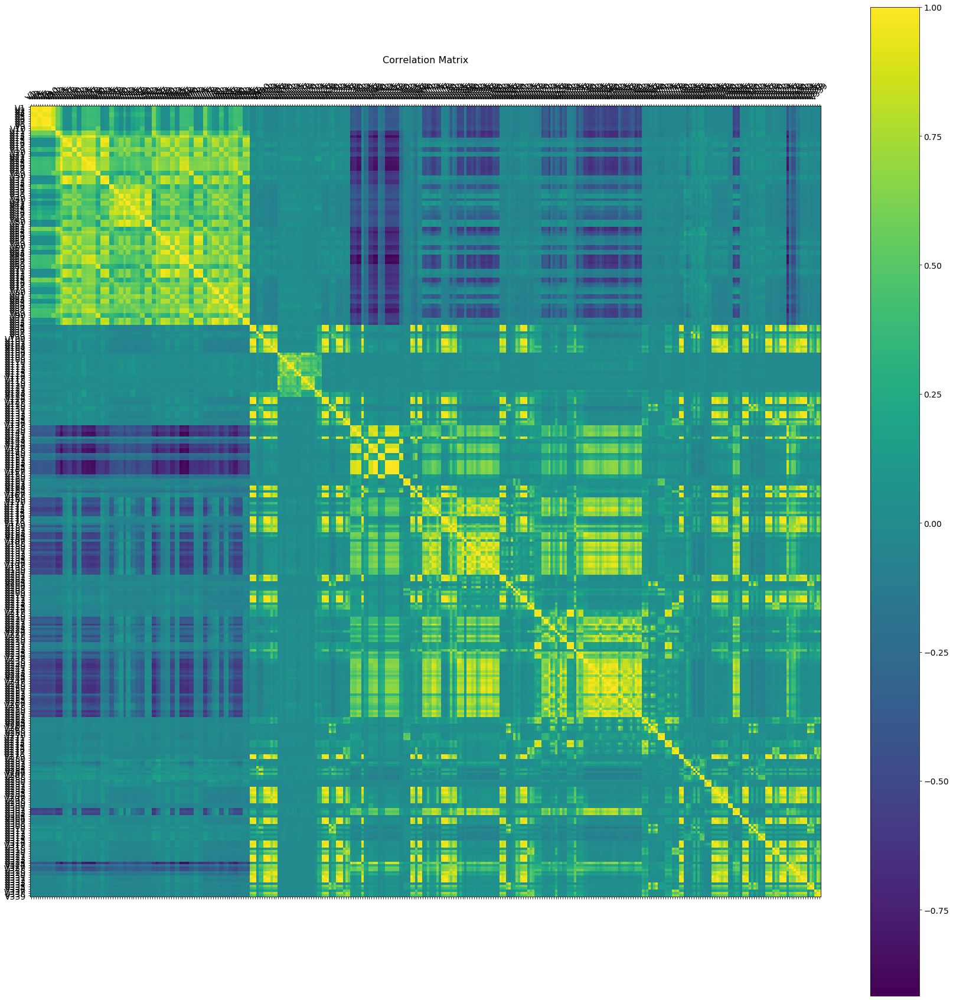

In [56]:
f = plt.figure(figsize=(30, 30))
plt.matshow(df_test.corr(), fignum=f.number)
plt.xticks(range(df_test.shape[1]), df_test.columns, fontsize=14, rotation=45)
plt.yticks(range(df_test.shape[1]), df_test.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [57]:
df_test.corr().style.background_gradient(cmap='coolwarm').set_precision(2)

In [58]:
df_categorical = df[V_categorical]

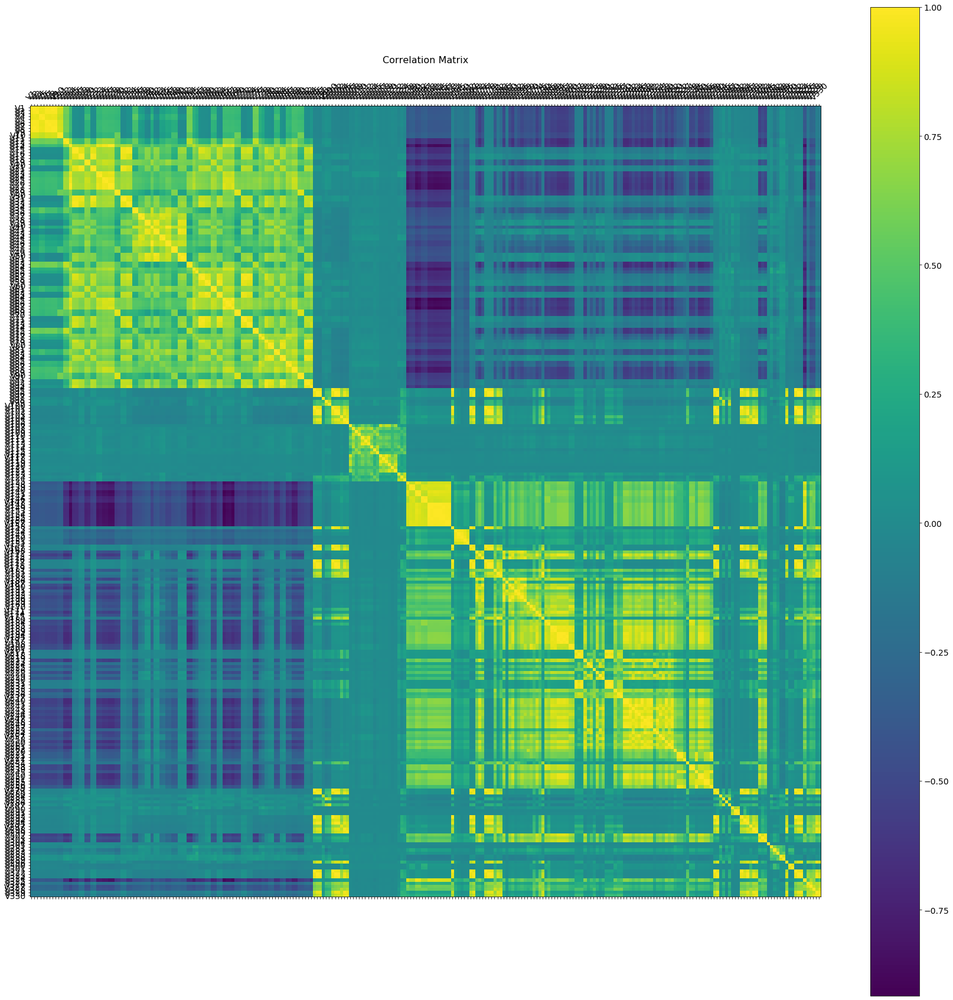

In [59]:
f = plt.figure(figsize=(30, 30))
plt.matshow(df_categorical.corr(), fignum=f.number)
plt.xticks(range(df_categorical.shape[1]), df_categorical.columns, fontsize=14, rotation=45)
plt.yticks(range(df_categorical.shape[1]), df_categorical.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [16]:
df_non_categorical = df[V_non_categorical]

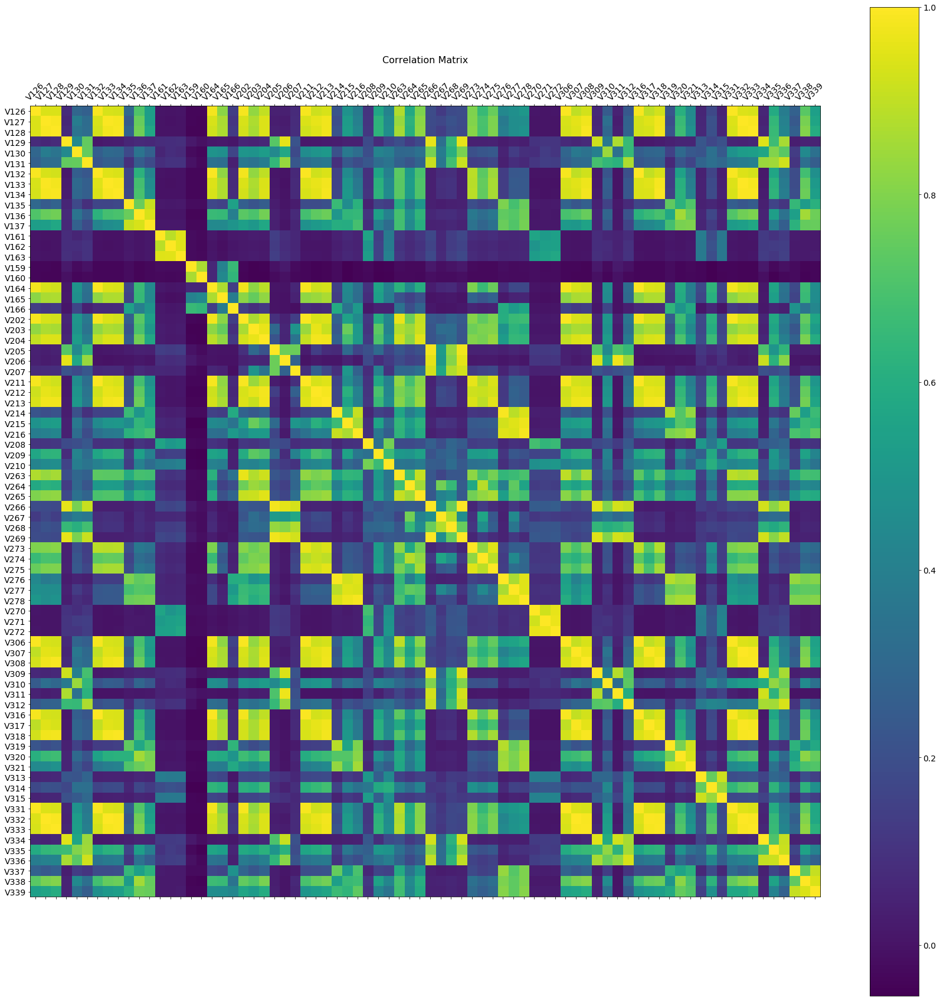

In [18]:
f = plt.figure(figsize=(30, 30))
plt.matshow(df_non_categorical.corr(), fignum=f.number)
plt.xticks(range(df_non_categorical.shape[1]), df_non_categorical.columns, fontsize=14, rotation=45)
plt.yticks(range(df_non_categorical.shape[1]), df_non_categorical.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [23]:
x=df[['V126', 'V127', 'V128']]

In [26]:
x.corr().style.background_gradient(cmap='coolwarm').set_precision(2)

,V126,V127,V128
V126,1.00,0.94,0.94
V127,0.94,1.00,0.99
V128,0.94,0.99,1.00


In [142]:
#set2=set1+['isFraud']

In [27]:
#x=df[set2].dropna()
#x.describe()

In [25]:
df_non_categorical.corr().style.background_gradient(cmap='coolwarm').set_precision(2)

In [68]:
#sm = scatter_matrix(x, figsize=(12,12), alpha=.3)

In [28]:
total = df['TransactionID'].count()
for col in df.columns:
    ser = df[col]
    num_nans = ser.isna().sum()
    uniques = ser.unique()
    num_uniques = len(uniques)
    print('{} has {} unique {} values and {}({:.2f}%) nan values'.format(col,num_uniques,type(uniques[0]),num_nans,num_nans/total*100))
    
    if num_uniques > 20:
        print(col,uniques[:8],' ... ',uniques[-8:],"\n")
    else:
        print(col,uniques,"\n")

TransactionID has 590540 unique <class 'numpy.int64'> values and 0(0.00%) nan values
TransactionID [2987000 2987001 2987002 2987003 2987004 2987005 2987006 2987007]  ...  [3577532 3577533 3577534 3577535 3577536 3577537 3577538 3577539] 

isFraud has 2 unique <class 'numpy.int64'> values and 0(0.00%) nan values
isFraud [0 1] 

TransactionDT has 573349 unique <class 'numpy.int64'> values and 0(0.00%) nan values
TransactionDT [86400 86401 86469 86499 86506 86510 86522 86529]  ...  [15811007 15811029 15811030 15811047 15811049 15811079 15811088 15811131] 

TransactionAmt has 20902 unique <class 'numpy.float64'> values and 0(0.00%) nan values
TransactionAmt [ 68.5  29.   59.   50.   49.  159.  422.5  15. ]  ...  [  41.111   65.32   480.71  2286.27  1615.74   557.54  1659.95   400.78 ] 

ProductCD has 5 unique <class 'str'> values and 0(0.00%) nan values
ProductCD ['W' 'H' 'C' 'S' 'R'] 

card1 has 13553 unique <class 'numpy.int64'> values and 0(0.00%) nan values
card1 [13926  2755  4663 181

In [29]:
addr_df = df[addr_cols]
addr_df.head(10)

,addr1,addr2
0,315.0,87.0
1,325.0,87.0
2,330.0,87.0
3,476.0,87.0
4,420.0,87.0
5,272.0,87.0
6,126.0,87.0
7,325.0,87.0
8,337.0,87.0
9,204.0,87.0


In [30]:
card_df = df[card_cols]
card_df.head(10)

,card1,card2,card3,card4,card5,card6
0,13926,NaN,150.0,discover,142.0,credit
1,2755,404.0,150.0,mastercard,102.0,credit
2,4663,490.0,150.0,visa,166.0,debit
3,18132,567.0,150.0,mastercard,117.0,debit
4,4497,514.0,150.0,mastercard,102.0,credit
5,5937,555.0,150.0,visa,226.0,debit
6,12308,360.0,150.0,visa,166.0,debit
7,12695,490.0,150.0,visa,226.0,debit
8,2803,100.0,150.0,visa,226.0,debit
9,17399,111.0,150.0,mastercard,224.0,debit


In [31]:
C_df = df[C_cols]
C_df.head(10)

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0
1,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
2,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
3,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0
4,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0
5,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
6,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
7,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
8,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0
9,2.0,2.0,0.0,0.0,0.0,3.0,0.0,0.0,3.0,0.0,1.0,0.0,12.0,2.0


In [32]:
D_df = df[D_cols]
D_df.head(10)

,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15
0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0
1,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
2,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0
3,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0
4,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
6,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
7,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
8,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,61.0,61.0,30.0,318.0,30.0,NaN,NaN,NaN,NaN,40.0,302.0,NaN,NaN,NaN,318.0


In [33]:
M_df = df[M_cols]
M_df.head(10)

,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,T,T,T,M2,F,T,NaN,NaN,NaN
1,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN
2,T,T,T,M0,F,F,F,F,F
3,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,T,T,T,M1,F,T,NaN,NaN,NaN
6,T,T,T,M0,F,F,T,T,T
7,NaN,NaN,NaN,M0,F,F,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,T,T,T,M0,T,T,NaN,NaN,NaN


In [34]:
test_df = df[['V1', 'D11']]
test_df.head(10)

,V1,D11
0,1.0,13.0
1,-1.0,NaN
2,1.0,315.0
3,-1.0,NaN
4,-1.0,NaN
5,1.0,0.0
6,1.0,0.0
7,-1.0,NaN
8,-1.0,NaN
9,1.0,302.0


In [35]:
x=df[['V1']].isna()
y=df[['D11']].isna()
(x.values ^ y.values).sum()

279287

In [ ]:
co=test_df.corr()
co

In [ ]:
sm = scatter_matrix(test_df, figsize=(12,12), alpha=.3)

In [ ]:
n=corr.shape[0]
x = np.unique(corr.values.reshape(n**2))
np.max(np.abs(x[x < 1]))

In [ ]:
sm = scatter_matrix(df_f, figsize=(12,12), alpha=.3)

In [ ]:
hist = df_f.hist(bins=1000, layout=(1,n), figsize=(20,5), sharex=False)

In [ ]:
hist = df_f.plot.hist(bins=10,alpha=0.3)

In [ ]:
x1 = df.iloc[:,1]
x2 = df.iloc[:,3]
np.dot(x1,x2)

In [ ]:
corr

In [ ]:
ser = df['V327']
ser.describe()

In [ ]:
ser.plot(kind='bar')

In [ ]:
str(5.type())

In [ ]:
type?

In [ ]:
dir(type)

In [72]:
~df[V_cols].isna().values

array([[ True,  True,  True, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [ True,  True,  True, ..., False, False, False],
       ...,
       [ True,  True,  True, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [76]:
#all_vals = list(map(np.array, [food_vals, stone_vals, lumber_vals, iron_vals, silver_vals]))
total = reduce((lambda x, y: x & y), ~df[V_cols].isna().values.T)

In [77]:
total.shape

(10000,)

In [78]:
total

array([False, False, False, ..., False, False, False])

In [80]:
V_cols_nan = reduce((lambda x, y: x & y), ~df[V_cols].isna().values.T)

In [81]:
X_train = df[V_cols].loc[V_cols_nan]

In [82]:
y_train = df[['isFraud']].loc[V_cols_nan]

In [83]:
X_train

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339


In [115]:
Counter(df['isFraud'].values.tolist())

Counter({0: 9735, 1: 265})

In [84]:
dtclf = tree.DecisionTreeClassifier(criterion='entropy')
clf = dtclf.fit(X_train, y_train)

ValueError: Found array with 0 sample(s) (shape=(0, 339)) while a minimum of 1 is required.

In [36]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()

In [ ]:
df[V_categorical] = enc.fit_transform(df[V_categorical])

In [86]:
enc.categories_

[array([-1.,  0.,  1.,  2.,  3.,  4.,  5.]),
 array([-1.,  0.,  1.,  2.,  3.,  4.])]

In [87]:
z['V2'].unique()

array([2., 0., 3., 4., 1., 5.])

In [88]:
enc.transform([[0,2]])

array([[1., 3.]])

In [90]:
enc.inverse_transform([[1,3]])

array([[0., 2.]])

In [46]:
from sklearn.naive_bayes import CategoricalNB
catNB = CategoricalNB()

In [91]:
enc.transform(z['V2'])

ValueError: Expected 2D array, got 1D array instead:
array=[2. 0. 2. ... 0. 0. 0.].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

In [ ]:
df.groupby(by=df.columns, axis=1).mean()